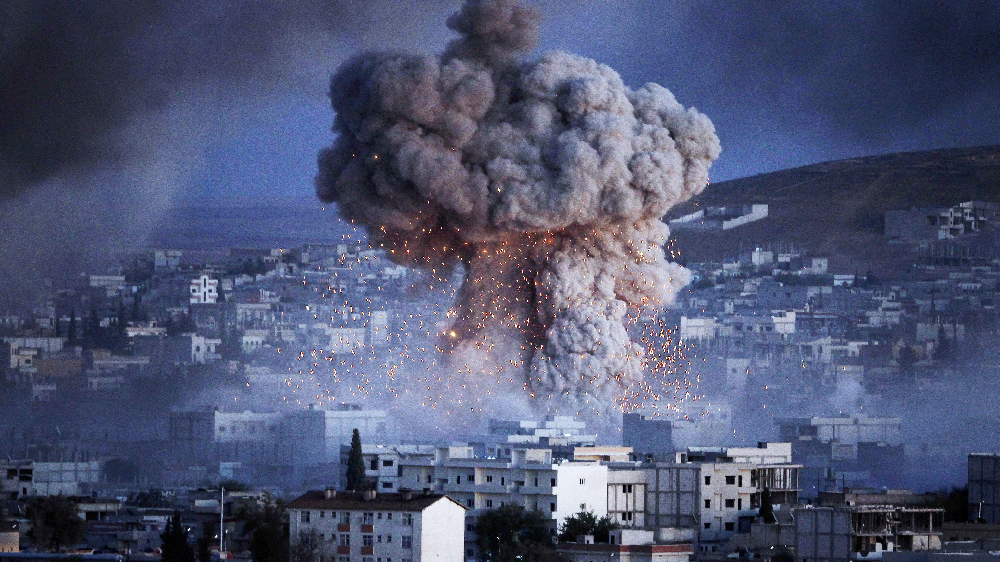

In [2]:
from IPython import display
display.Image(r"C:\Users\Hp\Desktop\terror.jpg")

# Data Science Intern @Lets Grow More

**Author: Nikita Kumbhar.**

# Task : Exploratory Data Analysis on Dataset - Terrorism 
                  (Level - Intermediate)


By using Exploratory Data Analysis(EDA) to find hidden information in data.

In [1]:
# Importing the libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import os
import warnings
warnings.filterwarnings('ignore')
from matplotlib import style
import plotly.express as px

In [2]:
#Loading Dataset
data = pd.read_csv(r'C:\Users\Hp\Downloads\archive\globalterrorismdb_0718dist.csv',encoding='ISO-8859-1')
data.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [3]:
data.shape

(181691, 135)

**We see in this dataset 181691 rows and 135 columns.**

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


In [5]:
data.isna().sum()

eventid            0
iyear              0
imonth             0
iday               0
approxdate    172452
               ...  
INT_LOG            0
INT_IDEO           0
INT_MISC           0
INT_ANY            0
related       156653
Length: 135, dtype: int64

In [6]:
#Selecting Columns
data = data[['iyear','country_txt','city','region_txt','attacktype1_txt','weaptype1_txt','targtype1_txt', 'gname']]
data.head()

,iyear,country_txt,city,region_txt,attacktype1_txt,weaptype1_txt,targtype1_txt,gname
0,1970,Dominican Republic,Santo Domingo,Central America & Caribbean,Assassination,Unknown,Private Citizens & Property,MANO-D
1,1970,Mexico,Mexico city,North America,Hostage Taking (Kidnapping),Unknown,Government (Diplomatic),23rd of September Communist League
2,1970,Philippines,Unknown,Southeast Asia,Assassination,Unknown,Journalists & Media,Unknown
3,1970,Greece,Athens,Western Europe,Bombing/Explosion,Explosives,Government (Diplomatic),Unknown
4,1970,Japan,Fukouka,East Asia,Facility/Infrastructure Attack,Incendiary,Government (Diplomatic),Unknown


In [7]:
#Renaming Columns
data=data.rename(columns = {'iyear':'Year','country_txt':'Country','city':'City','region_txt':'Region','attacktype1_txt':'Attack_Type','weaptype1_txt':'Weapon_Type',
                            'targtype1_txt':'Target_Type','gname':'Affiliation'})
data.head()

,Year,Country,City,Region,Attack_Type,Weapon_Type,Target_Type,Affiliation
0,1970,Dominican Republic,Santo Domingo,Central America & Caribbean,Assassination,Unknown,Private Citizens & Property,MANO-D
1,1970,Mexico,Mexico city,North America,Hostage Taking (Kidnapping),Unknown,Government (Diplomatic),23rd of September Communist League
2,1970,Philippines,Unknown,Southeast Asia,Assassination,Unknown,Journalists & Media,Unknown
3,1970,Greece,Athens,Western Europe,Bombing/Explosion,Explosives,Government (Diplomatic),Unknown
4,1970,Japan,Fukouka,East Asia,Facility/Infrastructure Attack,Incendiary,Government (Diplomatic),Unknown


In [8]:
data.columns

Index(['Year', 'Country', 'City', 'Region', 'Attack_Type', 'Weapon_Type',
       'Target_Type', 'Affiliation'],
      dtype='object')

In [9]:
data['Year'].unique()

array([1970, 1971, 1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980,
       1981, 1986, 1982, 1983, 1984, 1985, 1987, 1988, 1989, 1990, 1991,
       1992, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003,
       2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014,
       2015, 2016, 2017], dtype=int64)

In [10]:
data['Country'].unique()

array(['Dominican Republic', 'Mexico', 'Philippines', 'Greece', 'Japan',
       'United States', 'Uruguay', 'Italy', 'East Germany (GDR)',
       'Ethiopia', 'Guatemala', 'Venezuela', 'West Germany (FRG)',
       'Switzerland', 'Jordan', 'Spain', 'Brazil', 'Egypt', 'Argentina',
       'Lebanon', 'Ireland', 'Turkey', 'Paraguay', 'Iran',
       'United Kingdom', 'Colombia', 'Bolivia', 'Nicaragua',
       'Netherlands', 'Belgium', 'Canada', 'Australia', 'Pakistan',
       'Zambia', 'Sweden', 'Costa Rica', 'South Yemen', 'Cambodia',
       'Israel', 'Poland', 'Taiwan', 'Panama', 'Kuwait',
       'West Bank and Gaza Strip', 'Austria', 'Czechoslovakia', 'India',
       'France', 'South Vietnam', 'Brunei', 'Zaire',
       "People's Republic of the Congo", 'Portugal', 'Algeria',
       'El Salvador', 'Thailand', 'Haiti', 'Sudan', 'Morocco', 'Cyprus',
       'Myanmar', 'Afghanistan', 'Peru', 'Chile', 'Honduras',
       'Yugoslavia', 'Ecuador', 'New Zealand', 'Malaysia', 'Singapore',
       'Bot

In [11]:
data['Region'].unique()

array(['Central America & Caribbean', 'North America', 'Southeast Asia',
       'Western Europe', 'East Asia', 'South America', 'Eastern Europe',
       'Sub-Saharan Africa', 'Middle East & North Africa',
       'Australasia & Oceania', 'South Asia', 'Central Asia'],
      dtype=object)

In [12]:
data['Attack_Type'].unique()

array(['Assassination', 'Hostage Taking (Kidnapping)',
       'Bombing/Explosion', 'Facility/Infrastructure Attack',
       'Armed Assault', 'Hijacking', 'Unknown', 'Unarmed Assault',
       'Hostage Taking (Barricade Incident)'], dtype=object)

In [13]:
data['Weapon_Type'].unique()

array(['Unknown', 'Explosives', 'Incendiary', 'Firearms', 'Chemical',
       'Melee', 'Sabotage Equipment',
       'Vehicle (not to include vehicle-borne explosives, i.e., car or truck bombs)',
       'Fake Weapons', 'Radiological', 'Other', 'Biological'],
      dtype=object)

In [14]:
data['Target_Type'].unique()

array(['Private Citizens & Property', 'Government (Diplomatic)',
       'Journalists & Media', 'Police', 'Utilities', 'Military',
       'Government (General)', 'Airports & Aircraft', 'Business',
       'Educational Institution', 'Violent Political Party',
       'Religious Figures/Institutions', 'Unknown', 'Transportation',
       'Tourists', 'NGO', 'Telecommunication', 'Food or Water Supply',
       'Terrorists/Non-State Militia', 'Other', 'Maritime',
       'Abortion Related'], dtype=object)

In [15]:
data['Affiliation'].unique()

array(['MANO-D', '23rd of September Communist League', 'Unknown', ...,
       'Fatoni Warriors', 'Minorities of Metropolitan Attacks',
       'Baloch Republican Party'], dtype=object)

In [16]:
data['City'].unique()

array(['Santo Domingo', 'Mexico city', 'Unknown', ..., 'Hungrum',
       'Ceelka Geelow', 'Kubentog'], dtype=object)

In [17]:
#Dropping duplicate rows and keeping the first duplicate row
data = data.drop_duplicates(keep='first')
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 128545 entries, 0 to 181690
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   Year         128545 non-null  int64 
 1   Country      128545 non-null  object
 2   City         128315 non-null  object
 3   Region       128545 non-null  object
 4   Attack_Type  128545 non-null  object
 5   Weapon_Type  128545 non-null  object
 6   Target_Type  128545 non-null  object
 7   Affiliation  128545 non-null  object
dtypes: int64(1), object(7)
memory usage: 8.8+ MB


<Figure size 1000x600 with 0 Axes>

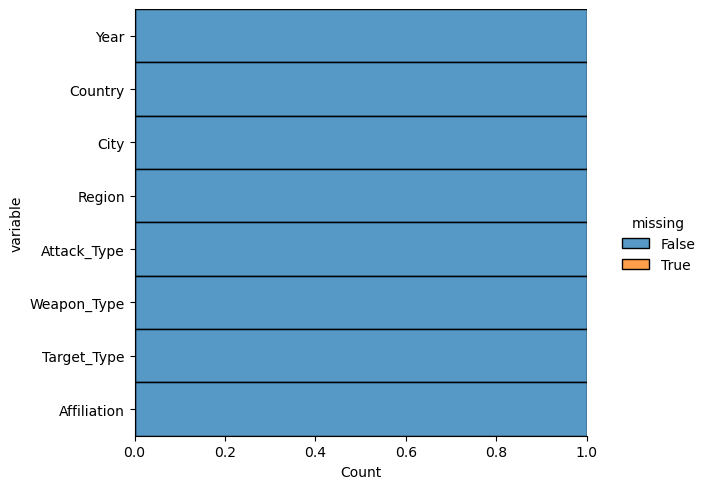

In [18]:
#Determining Which Variables Have Missing Values
plt.figure(figsize=(10,6))
sns.displot(
    data=data.isna().melt(value_name="missing"),
    y="variable",
    hue="missing",
    multiple="fill",
    aspect=1.25
)
plt.savefig("visualizing_missing_data_with_barplot_Seaborn_distplot.png", dpi=100)

**Zero missing value in the data set.**

# Data visualization

# Number Of Terrorist Attacks Each Year <a class="anchor" id="section_3_1"></a>

In [19]:
#Making a new column called YearCount which is the sum of the number of terrorist attacks for each year and additing it to dataframe
data['YearCount'] = data.Year.groupby(data.Year).transform('count')

#Creating new Dataframe to get only Year and YearCount and dropping duplicates from Year
data1 = data.copy()
data2 = data1[['Year','YearCount']]
data3 = data2.drop_duplicates(keep='first')

#Line Graph
fig = px.line(data3, x="Year", y="YearCount", title='Number of Terrorist Attacks Each Year')
fig.update_xaxes(range = [1970,2017])
fig.show()

**This line plot shows us that in there is a huge increase in terrorism during the 2000's as opposed to 1970-2000. 2014 had the most terrorist attacks. The biggest increase in terrorist attacks is from 2010-2014 and that after 2014, the number of terrorist attacks is decreasing. Now we will take a look at which regions had the most attacks throughout the years.**

# Terrorist Attacks By Region

In [20]:
#Making a new column called RegionCount which only has value of 1 for each row - this way histogram will sum up values correctly
data['RegionCount'] = 1

#Histogram
fig = px.histogram(data, x="Region", y="RegionCount", color="Region", 
                   title="Terrorist Attacks By Region", labels=dict(RegionCount = "Count"),
                   hover_data=data).update_xaxes(categoryorder = "total descending")
fig.show()

**Here we see that South Asia, the Middle East & North Africa, Sub-Saharan-Africa, and South America have the most terrorism attacks. There is also a trend that the Western countries tend to have less terrorism attacks than the 3rd world countries. It is also not surprising to see that regions like South Asia, Middle East, Africa, and South America are the top ranking in terms of terrorism attacks due to the large disparities in wealth, differences in religions, as well as territorial disputes over oil. We will now delve deeper into seeing which countries had the most terrorist attacks.**

# Number of Terrorist Attacks By Country

In [21]:
data['Country'].value_counts().head(10)

India             10499
Afghanistan       10137
Pakistan           9835
Iraq               9525
Colombia           6446
Philippines        6156
Peru               3587
United Kingdom     3500
Turkey             3170
Nigeria            3128
Name: Country, dtype: int64

In [22]:
#World Map
geo=pd.DataFrame({'Country': data['Country'].value_counts().index,
                   'Number_of_Attacks': data['Country'].value_counts().values})

fig = px.choropleth(geo, locations="Country", 
                    locationmode="country names", color="Number_of_Attacks", 
                    hover_name="Country", range_color=[1, 1000], 
                    color_continuous_scale="blues", 
                    title='Number of Terrorist Attacks by Country')
fig.update(layout_coloraxis_showscale=True)
fig.show()

**This geographic map depicts the countries with the most terrorist attacks. From this map we can see that the areas with the highest terrorist attacks are in dark blue, while the areas with the least are in white. This map verifies what we already discovered, that the countries with the most attacks tend to be those in South Asia, Middle East & North Africa, and South America.**

# Cities With The Most Terrorist Attacks.

In [23]:
data.City.value_counts().head(15)

Unknown         5540
Belfast          961
Baghdad          820
Karachi          801
Lima             704
San Salvador     630
Athens           625
Santiago         603
Bogota           581
Beirut           563
Istanbul         558
Mogadishu        518
Mosul            467
Srinagar         440
Paris            434
Name: City, dtype: int64

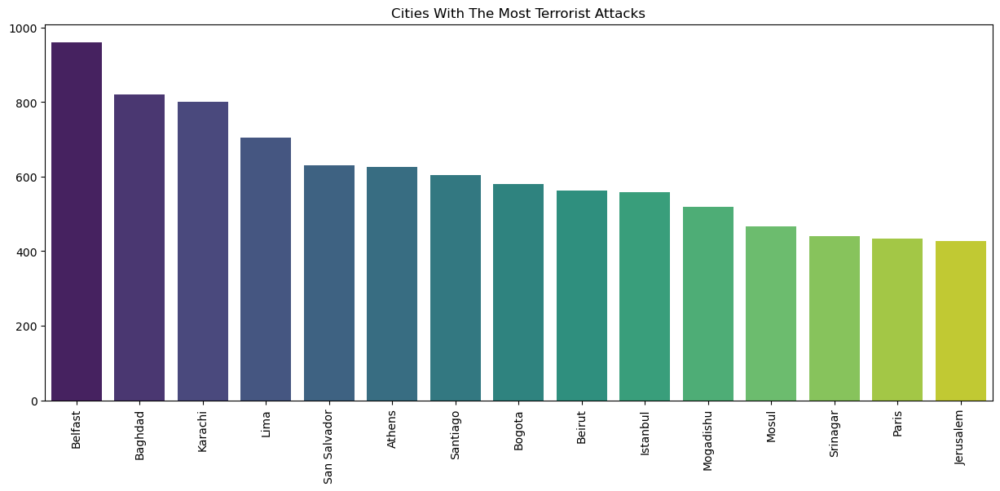

In [24]:
#Creating new dataframe without Unknown Category
filtered = data[data['City'] != 'Unknown']

#Barplot
plt.subplots(figsize=(15,6))
sns.barplot(filtered['City'].value_counts().head(15).index, filtered['City'].value_counts().head(15).values, 
            palette = "viridis")
plt.xticks(rotation=90)
plt.title('Cities With The Most Terrorist Attacks')
plt.show()

**From the barplot, we see that the top 5 cities with terrorism attacks are Belfast, Baghdad, Karachi, Lima, and San Salvador. It is surprising to see that Belfast, Ireland is the top city for terrorist attacks since according to the interactive map we just created, Ireland isn't one of the countries with the highest terrorist attacks.** 

# Terrorist Attack Types

In [25]:
#Making a new column called AttackCount which is the sum of each type of terrorist attack and adding it to dataframe
data['AttackCount'] = data.Attack_Type.groupby(data.Attack_Type).transform('count')

#Creating new Dataframe to get only Attack Type and AttackCount and dropping duplicates from Attack Type
data1 = data.copy()
data2 = data1[['Attack_Type','AttackCount']]
data3 = data2.drop_duplicates(keep='first')

#Pie Chart
fig = px.pie(data3, values="AttackCount",
             names="Attack_Type",title='Terrorist Attack Types',
             color_discrete_sequence=px.colors.sequential.RdBu)
fig.show()

**From the pie chart, the most common type of terrorist weapons used are Bombing/Explosions, followed by Armed Assault, and Assassinations. The reason that bombings/explosions are the most common type of terrorist attack is likely due to how the information to make bombs is easily available, it is easier to use a bomb or explosive than attempt things like armed assault or assassinations, as well as the fact that there aren't things like background checks when it comes to getting a bomb as opposed to trying to get a firearm or get close enough to assassinate someone important.** 

# Terrorist Weapon Types

In [26]:
import plotly.graph_objects as go
#Making a new column called WeaponCount which is the sum of each type of weapon and adding it to dataframe
data['WeaponCount'] = data.Weapon_Type.groupby(data.Weapon_Type).transform('count')

#Creating new Dataframe to get only Weapon Type and WeaponCount and dropping duplicates from Weapon Type
data1 = data.copy()
data2 = data1[['Weapon_Type','WeaponCount']]
data3 = data2.drop_duplicates(keep='first')

#Creating Donut Chart
labels = data3['Weapon_Type'].unique()
values = data3['WeaponCount']
fig = go.Figure(data=[go.Pie(labels=labels, values=values, hole=.3)])
fig.update_layout(
    title_text="Terrorist Weapon Types")
fig.show()

**From the donut chart, we see that the most common types of weapons used by terrorists are explosives and firearms. This also followed the trend from above where most attack types used bombs/explosives. Firearms are also easily obtainable which makes sense why it is a favorite weapon of choice for terrorists.**

# Terrorist Targets

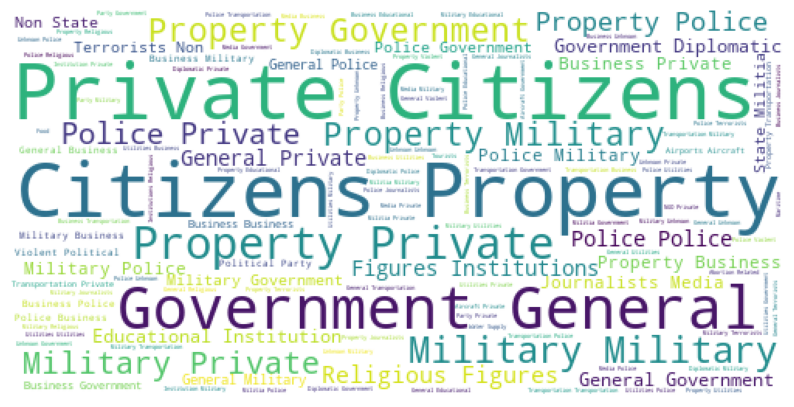

In [27]:
#Word Cloud
from wordcloud import WordCloud
Targets=data.Target_Type.dropna(False)
plt.subplots(figsize=(10,10))
wordcloud= WordCloud(background_color='white', width=500, height = 250).generate(' '.join(Targets))
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

**From the Word Cloud we see that the most common target types are Citizens & Private Property, Private Citizens, and Government General. This is likely due to how terrorism attacks tend to be against individuals related to certain groups as opposed to just the general population. We will now look at what the largest terrorist groups are.**

# Largest Terrorist Groups 

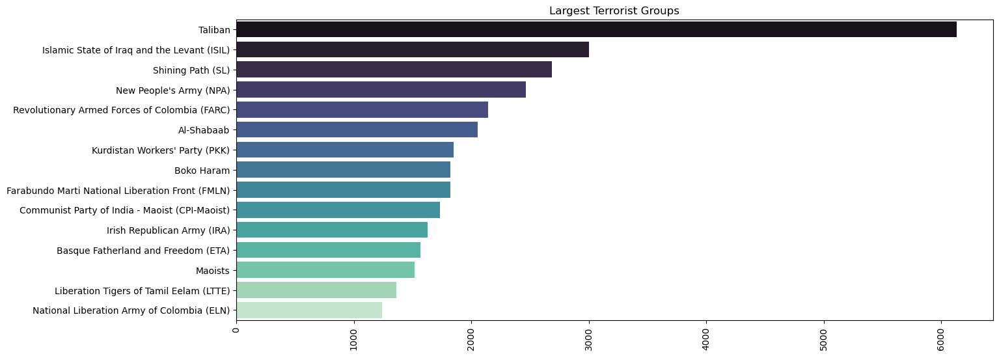

In [28]:
#Creating new dataframe without Unknown Category
filtered = data[data['Affiliation'] != 'Unknown']

#Horizontal Barplot
plt.subplots(figsize=(15,6))
sns.barplot(filtered['Affiliation'].value_counts().head(15).values, filtered['Affiliation'].value_counts().head(15).index, 
            palette = "mako")
plt.xticks(rotation=90)
plt.title('Largest Terrorist Groups')
plt.show()

**From the horizontal barplot, we can see that the 5 largest terrorist groups are the Taliban, ISIL, Shining Path, Al-Shabaab, and New People's Army (NPA). The first 4 groups aren't surprising since they are all in the Middle East & North Africa areas, but New People's Army is the armed wing of the Communist Party in the Philippines.**  

# Most Common India Terrorist Profile

The purpose of this part of the analysis is to just to take a general look at what is the most likely profile of a Indian terrorist. I am interested in this because I am a Indian.

In [29]:
#Subsetting data to only include entries for India
India = data[data['Country'] =='India']

#Removing Unknown in Affiliation
filtered = India[India['Affiliation'] != 'Unknown']

#Profile
print("Year With The Most Attacks:",India['Year'].value_counts().idxmax())

print("Most Common Attack Type:",India['Attack_Type'].value_counts().idxmax())

print("Most Common Weapon Type:",India['Weapon_Type'].value_counts().idxmax())

print("Most Common Target Type:",India['Target_Type'].value_counts().idxmax())

print('Terrorist Group with Highest Number Of Terror Attacks:', filtered['Affiliation'].value_counts().idxmax())

Year With The Most Attacks: 2016
Most Common Attack Type: Bombing/Explosion
Most Common Weapon Type: Explosives
Most Common Target Type: Private Citizens & Property
Terrorist Group with Highest Number Of Terror Attacks: Communist Party of India - Maoist (CPI-Maoist)


**The year with the most attacks is 2016, which is also the year that Roe vs. Wade lawsuit was filed and the Texas law was declared unconstitutional due to violating the right to privacy. This debate over Roe vs. Wade is likely the major cause of the why there were so many terrorist attacks in 2016.**

**Bombings/explosives being the most used attack of choice as well as weapon of choice in the India follows the trend of bombings/explosives being the most common attack type for terrorism in other countries also.**

**The most common target type in the India being Private Citizens and Property.**

# [THANK YOU!](chapeter1)

SyntaxError: invalid syntax (966375345.py, line 1)